https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95?fbclid=IwAR3WB8cL1Qk7icQgbjaj8rw3iGGjo8M4wRIiEAb3zZC8anTow9uV4IvxTcU
https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Vehicles/bm4k-52h4?fbclid=IwAR17Ba6CEepQQTKNt5qIB-p2QQmSWS8HrTei1kygpXaWkKQeutg3IPGVjuo
https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Person/f55k-p6yu?fbclid=IwAR1k9QCQYOXIHXw061OGsCp0kmBlFOrSl310kjpSIpp2CYdgVb6odkgNm20

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import shapefile as shp
import urllib, gdal, subprocess
import json
import requests
import folium
import datetime
import warnings
import random
warnings.filterwarnings("ignore")

sns.set(style='darkgrid', palette='muted', color_codes=True)
#sns.mpl.rc('figure', figsize=(10,6))
# Set a plot style for nice plots.

# Magic command useful jupyter notebook
%matplotlib inline



#Set font size
plt.rcParams.update({'font.size':16})

In [2]:
%%time
filename = "Motor_Vehicle_Collisions_-_Crashes.csv"
filename2 = "Motor_Vehicle_Collisions_-_Person.csv"
# filename = "crash_clean.csv"
p = 0.2 # 1% of the lines
# keep the header, then take only 1% of lines
# if random from [0,1] interval is greater than 0.01 the row will be skipped
df = pd.read_csv(
         filename,
         header=0, 
         skiprows=lambda i: i>0 and random.random() > p)

df2 = pd.read_csv(
         filename2,
         header=0, 
         skiprows=lambda i: i>0 and random.random() > p)

Wall time: 26.5 s


In [3]:
df.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,09/03/2018,21:39,NaN,NaN,40.749172,-73.967026,POINT (-73.967026 40.749172),FDR DRIVE,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3973213,Sedan,Sedan,Station Wagon/Sport Utility Vehicle,Sedan,Station Wagon/Sport Utility Vehicle
1,09/07/2018,19:20,BROOKLYN,11223,40.600590,-73.961370,POINT (-73.96137 40.60059),CONEY ISLAND AVENUE,AVENUE T,NaN,...,Unspecified,NaN,NaN,NaN,3976336,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN
2,09/06/2018,11:17,NaN,NaN,40.608757,-74.038086,POINT (-74.038086 40.608757),VERRAZANO BRIDGE LOWER,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3975964,Sedan,Sedan,Sedan,Sedan,Sedan
3,09/03/2018,21:50,QUEENS,11412,40.686450,-73.761185,POINT (-73.761185 40.68645),FARMERS BOULEVARD,120 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,3973840,Motorcycle,Sedan,NaN,NaN,NaN
4,09/02/2018,14:28,QUEENS,11374,40.713165,-73.859620,POINT (-73.85962 40.713165),NaN,NaN,69-28 WOODHAVEN BOULEVARD,...,Unspecified,NaN,NaN,NaN,3972428,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN


In [4]:
df.shape

(334844, 29)

In [5]:
df.isna().sum()

CRASH DATE                            0
CRASH TIME                            0
BOROUGH                          101867
ZIP CODE                         101906
LATITUDE                          40429
LONGITUDE                         40429
LOCATION                          40429
ON STREET NAME                    66622
CROSS STREET NAME                114510
OFF STREET NAME                  286746
NUMBER OF PERSONS INJURED             1
NUMBER OF PERSONS KILLED              4
NUMBER OF PEDESTRIANS INJURED         0
NUMBER OF PEDESTRIANS KILLED          0
NUMBER OF CYCLIST INJURED             0
NUMBER OF CYCLIST KILLED              0
NUMBER OF MOTORIST INJURED            0
NUMBER OF MOTORIST KILLED             0
CONTRIBUTING FACTOR VEHICLE 1       901
CONTRIBUTING FACTOR VEHICLE 2     45551
CONTRIBUTING FACTOR VEHICLE 3    313170
CONTRIBUTING FACTOR VEHICLE 4    330291
CONTRIBUTING FACTOR VEHICLE 5    333678
COLLISION_ID                          0
VEHICLE TYPE CODE 1                1206


In [6]:
df.describe()

,LATITUDE,LONGITUDE,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,COLLISION_ID
count,294415.000000,294415.000000,334843.000000,334840.000000,334844.000000,334844.000000,334844.000000,334844.000000,334844.000000,334844.000000,3.348440e+05
mean,40.688199,-73.864719,0.262356,0.001213,0.050671,0.000621,0.020392,0.000090,0.191095,0.000496,2.838476e+06
std,1.212202,2.460724,0.656223,0.036721,0.234768,0.024916,0.142409,0.009465,0.617044,0.025157,1.501443e+06
min,0.000000,-201.359990,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.500000e+01
25%,40.668957,-73.976460,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.816148e+06
50%,40.722572,-73.929245,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.474016e+06
75%,40.768257,-73.866650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.890474e+06
max,41.126150,0.000000,31.000000,4.000000,27.000000,1.000000,3.000000,1.000000,31.000000,4.000000,4.309026e+06


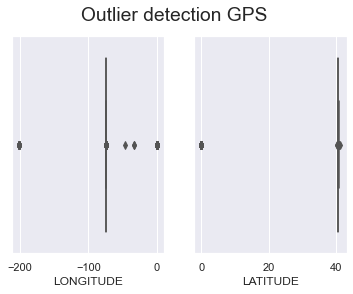

In [7]:
figure,(ax1,ax2) = plt.subplots(1,2)


plt.subplot(ax1)
ax1 = sns.boxplot(df.LONGITUDE)
plt.subplot(ax2)
ax2 = sns.boxplot(df.LATITUDE)

plt.suptitle('Outlier detection GPS')
plt.savefig('outlier')

In [8]:
df = df.loc[(df.LONGITUDE >-77) & (df.LONGITUDE < -69) & (df.LATITUDE <43) & (df.LATITUDE > 38)]


In [9]:
df.shape

(294130, 29)

In [10]:
from datashader.colors import colormap_select, Greys9, Hot, viridis, inferno
from bokeh.models import HoverTool
from bokeh.models.widgets import Panel, Tabs
import hvplot.pandas

In [11]:
NYC = x_range, y_range = ((-74.05, -73.7), (40.6, 40.9))

In [12]:
hover = HoverTool(tooltips=[("error", "$NUMBER OF PERSONS KILLED"),
                            ("state", "@NUMBER OF PERSONS KILLED")
                            
                           ])

In [13]:
df.hvplot.points(x='LONGITUDE',y='LATITUDE',xlim=x_range,ylim=y_range
                 ,logz=True,width=700,height=500,cmap=inferno,datashade=True).opts(bgcolor='black',
                                                                                  title='Vehicle Collisions and Crashes',tools=['hover'])


:DynamicMap   []
   :RGB   [LONGITUDE,LATITUDE]   (R,G,B,A)

In [14]:
df['CRASH TIME'] = pd.to_datetime(df['CRASH TIME'])
df['CRASH DATE'] = pd.to_datetime(df['CRASH DATE'])

In [15]:
df_snip = df.sample(n=10000)

In [16]:
# For each point the the dataframe create a marker on the map. 
mapz = folium.Map([40.730610, -73.935242], zoom_start=11)
for i in range(len(df_snip)):
    folium.CircleMarker([df_snip.LATITUDE.iloc[i], df_snip.LONGITUDE.iloc[i]],fill=True, # Set fill to True
                                fill_color='blue',
                                color = 'blue',
                                radius = 0.05
                 ).add_to(mapz)

# Display map
mapz

In [17]:
from folium import plugins
from folium.plugins import HeatMap

In [18]:
mapz = folium.Map([40.730610, -73.935242], zoom_start=13,tiles = 'Stamen Toner')

stationArr = df_snip[['LATITUDE', 'LONGITUDE']].values

# plot heatmap
mapz.add_children(plugins.HeatMap(stationArr, radius=13))
mapz

In [19]:
df_burg2015 = df_snip

In [20]:
import warnings
warnings.filterwarnings("ignore")

map_hooray = folium.Map(location=[40.730610, -73.935242],zoom_start = 12) 

# Filter the DF for rows, then columns, then remove NaNs
heat_df = df_burg2015[['LATITUDE', 'LONGITUDE']]

# Create weight column, using date
heat_df['Weight'] = df_burg2015['CRASH TIME'].dt.hour # extracting the date from the string
heat_df['Weight'] = heat_df['Weight'].astype(float)
heat_df = heat_df.dropna(axis=0, subset=['LATITUDE','LONGITUDE', 'Weight'])
# List comprehension to make out list of lists
heat_data = [[[row['LATITUDE'],row['LONGITUDE']] for index, row in heat_df[heat_df['Weight'] == i].iterrows()] for i in range(0,23)]

# Plot it on the map
hm = plugins.HeatMapWithTime(heat_data,auto_play=True,max_opacity=0.8)
hm.add_to(map_hooray)
# Display the map
map_hooray

In [21]:
df.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,2018-09-03,2020-04-26 21:39:00,NaN,NaN,40.749172,-73.967026,POINT (-73.967026 40.749172),FDR DRIVE,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3973213,Sedan,Sedan,Station Wagon/Sport Utility Vehicle,Sedan,Station Wagon/Sport Utility Vehicle
1,2018-09-07,2020-04-26 19:20:00,BROOKLYN,11223,40.600590,-73.961370,POINT (-73.96137 40.60059),CONEY ISLAND AVENUE,AVENUE T,NaN,...,Unspecified,NaN,NaN,NaN,3976336,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN
2,2018-09-06,2020-04-26 11:17:00,NaN,NaN,40.608757,-74.038086,POINT (-74.038086 40.608757),VERRAZANO BRIDGE LOWER,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3975964,Sedan,Sedan,Sedan,Sedan,Sedan
3,2018-09-03,2020-04-26 21:50:00,QUEENS,11412,40.686450,-73.761185,POINT (-73.761185 40.68645),FARMERS BOULEVARD,120 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,3973840,Motorcycle,Sedan,NaN,NaN,NaN
4,2018-09-02,2020-04-26 14:28:00,QUEENS,11374,40.713165,-73.859620,POINT (-73.85962 40.713165),NaN,NaN,69-28 WOODHAVEN BOULEVARD,...,Unspecified,NaN,NaN,NaN,3972428,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN


In [22]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
from datetime import datetime
import os
import folium
# from folium.plugins import MarkerCluster
import folium.plugins

NY_COORDINATES = (40, -73)
# gdata = pd.read_csv('green_tripdata.csv')
MAX_RECORDS = 10000
map_nyccrash = folium.Map(location=NY_COORDINATES, zoom_start=9)
marker_cluster = folium.plugins.MarkerCluster().add_to(map_nyccrash)
for each in df[0:MAX_RECORDS].iterrows():
    folium.Marker(
        location = [each[1]['LATITUDE'],each[1]['LONGITUDE']], popup=(each[1]['CRASH TIME'],each[1]['COLLISION_ID'])).add_to(marker_cluster)
map_nyccrash

In [23]:
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,LATITUDE,LONGITUDE,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,COLLISION_ID
LATITUDE,1.00,0.33,-0.02,-0.00,0.01,-0.00,-0.00,0.00,-0.02,-0.00,0.01
LONGITUDE,0.33,1.00,0.04,0.00,-0.01,0.00,-0.03,-0.00,0.05,0.00,0.06
NUMBER OF PERSONS INJURED,-0.02,0.04,1.00,0.02,0.31,0.00,0.17,-0.00,0.90,0.02,0.01
NUMBER OF PERSONS KILLED,-0.00,0.00,0.02,1.00,0.01,0.67,-0.00,0.26,0.01,0.69,-0.00
NUMBER OF PEDESTRIANS INJURED,0.01,-0.01,0.31,0.01,1.00,0.02,-0.03,-0.00,-0.06,-0.00,-0.03
NUMBER OF PEDESTRIANS KILLED,-0.00,0.00,0.00,0.67,0.02,1.00,-0.00,-0.00,-0.00,-0.00,-0.00
NUMBER OF CYCLIST INJURED,-0.00,-0.03,0.17,-0.00,-0.03,-0.00,1.00,0.00,-0.04,-0.00,-0.01
NUMBER OF CYCLIST KILLED,0.00,-0.00,-0.00,0.26,-0.00,-0.00,0.00,1.00,-0.00,-0.00,0.00
NUMBER OF MOTORIST INJURED,-0.02,0.05,0.90,0.01,-0.06,-0.00,-0.04,-0.00,1.00,0.02,0.02
NUMBER OF MOTORIST KILLED,-0.00,0.00,0.02,0.69,-0.00,-0.00,-0.00,-0.00,0.02,1.00,-0.00


In [24]:
count = df.groupby('NUMBER OF PERSONS KILLED').size()

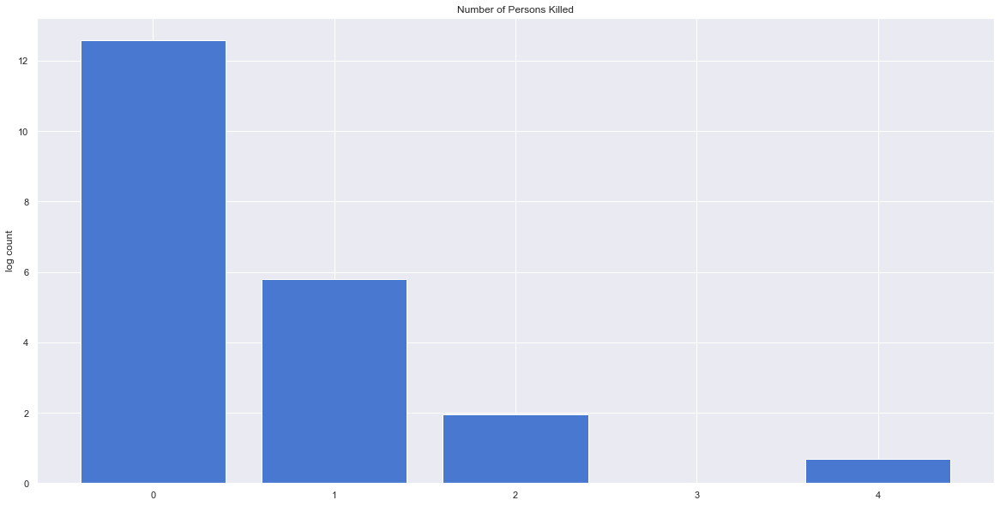

In [25]:
import math
count = count.sort_values(ascending=False)
height = np.log(count)
plt.figure(figsize=(20,10))
plt.bar(count.index,height)
plt.title('Number of Persons Killed')
plt.ylabel('log count')
plt.show()

Text(0.5, 1.0, 'Number of accidents, day of the week')

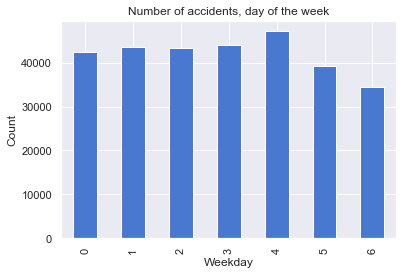

In [26]:
df.groupby(df['CRASH DATE'].dt.dayofweek).size().plot(kind='bar')
plt.xlabel('Weekday')
plt.ylabel('Count')
plt.title('Number of accidents, day of the week')

Text(0.5, 1.0, 'Number of accidents monthly')

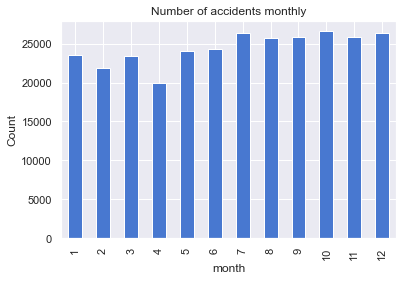

In [27]:
df.groupby(df['CRASH DATE'].dt.month).size().plot(kind='bar')
plt.xlabel('month')
plt.ylabel('Count')
plt.title('Number of accidents monthly')

Text(0.5, 1.0, 'Number of accidents Yearly')

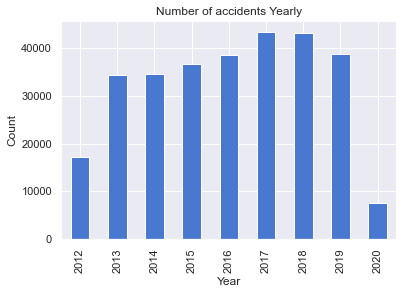

In [28]:
df.groupby(df['CRASH DATE'].dt.year).size().plot(kind='bar')
plt.xlabel('Year')
plt.ylabel('Count')
plt.title('Number of accidents Yearly')

Text(0.5, 1.0, 'Number of crashes hourly')

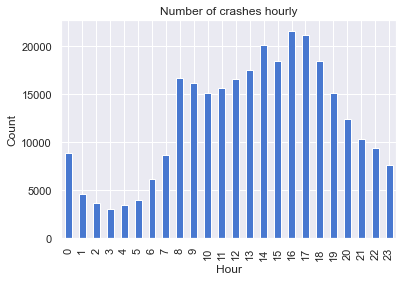

In [29]:
df.groupby(df['CRASH TIME'].dt.hour).size().plot(kind='bar')
plt.xlabel('Hour')
plt.ylabel('Count')
plt.title('Number of crashes hourly')

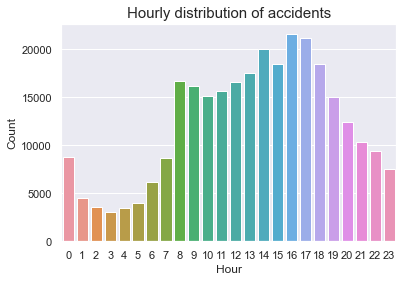

In [30]:
sns.countplot(df['CRASH TIME'].dt.hour)
plt.title('Hourly distribution of accidents',size=15)
plt.xlabel('Hour')
plt.ylabel('Count')
plt.savefig('hourly')

In [31]:
df2.head()

,UNIQUE_ID,COLLISION_ID,CRASH_DATE,CRASH_TIME,PERSON_ID,PERSON_TYPE,PERSON_INJURY,VEHICLE_ID,PERSON_AGE,EJECTION,...,BODILY_INJURY,POSITION_IN_VEHICLE,SAFETY_EQUIPMENT,PED_LOCATION,PED_ACTION,COMPLAINT,PED_ROLE,CONTRIBUTING_FACTOR_1,CONTRIBUTING_FACTOR_2,PERSON_SEX
0,10255094,4230662,10/25/2019,18:30,4dcb56e7-65eb-45ed-ac6b-85958df6ca5e,Occupant,Unspecified,19144098.0,29.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,M
1,10252277,4229851,10/26/2019,1:45,693fd448-6c71-423b-a6c5-f3d4ad93aa51,Occupant,Unspecified,19142671.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Registrant,NaN,NaN,U
2,10254054,4230608,10/26/2019,16:00,65385bcc-b778-4f36-8c87-284f8c1ff240,Occupant,Unspecified,19143564.0,25.0,Not Ejected,...,Does Not Apply,"Front passenger, if two or more persons, inclu...",Lap Belt & Harness,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,F
3,10248819,4229588,10/26/2019,14:00,bda6f90f-de2f-48ff-8834-d5dc9d7df442,Occupant,Unspecified,19141003.0,41.0,Not Ejected,...,Does Not Apply,"Front passenger, if two or more persons, inclu...",Lap Belt & Harness,NaN,NaN,Does Not Apply,Passenger,NaN,NaN,F
4,10248140,4229688,10/26/2019,9:47,5b9092f8-5774-48a4-9b67-dac6e55b7023,Occupant,Injured,19140681.0,46.0,Not Ejected,...,Knee-Lower Leg Foot,Driver,Unknown,NaN,NaN,Unknown,Driver,NaN,NaN,M


In [32]:
df2 = df2.dropna(subset = ['PERSON_AGE'])

In [33]:
# df = df.loc[(df.LONGITUDE >-77) & (df.LONGITUDE < -69) & (df.LATITUDE <43) & (df.LATITUDE > 38)]

In [34]:
df2 = df2.loc[(df2['PERSON_AGE']>0) & (df2['PERSON_AGE'] <100 )]

In [35]:
df2.shape

(612990, 21)

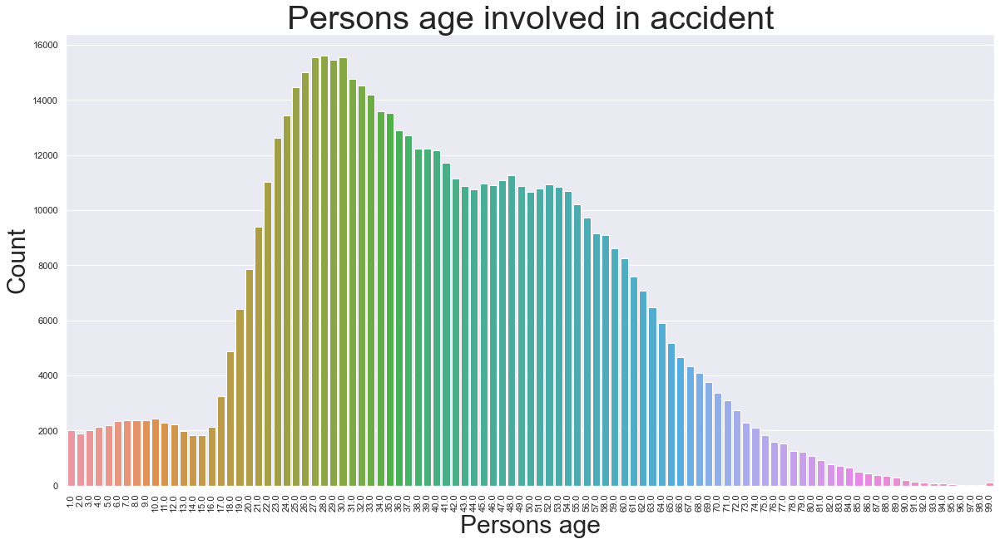

In [36]:
plt.figure(figsize=(20,10))
sns.countplot(df2['PERSON_AGE'])
plt.xlabel('Persons age',size=30)
plt.ylabel('Count',size=30)
plt.xticks(rotation=90)
plt.title('Persons age involved in accident',size=40)
plt.savefig('Age')

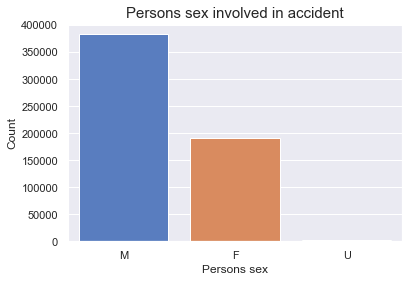

In [37]:
sns.countplot(df2['PERSON_SEX'])
plt.title('Persons sex involved in accident',size=15)
plt.xlabel('Persons sex')
plt.ylabel('Count')
plt.savefig('sex')

In [38]:
mask = df['NUMBER OF PERSONS KILLED'] >0
df_fat = df[mask]


In [39]:
df_fat.groupby('NUMBER OF PERSONS KILLED').size()

NUMBER OF PERSONS KILLED
1.0    325
2.0      7
3.0      1
4.0      2
dtype: int64

In [40]:
mapz = folium.Map([40.730610, -73.935242], zoom_start=11)
for i in range(len(df_fat)):
    folium.CircleMarker([df_fat.LATITUDE.iloc[i], df_fat.LONGITUDE.iloc[i]],fill=True, # Set fill to True
                                fill_color='blue',
                                color = 'blue',
                                radius = 0.05,
                        popup=('Number of persons killed', df_fat['NUMBER OF PERSONS KILLED'].iloc[i])
                 ).add_to(mapz)

# Display map
mapz

In [41]:
mapz = folium.Map([40.730610, -73.935242], zoom_start=12,tiles = 'Stamen Toner')

stationArr = df_fat[['LATITUDE', 'LONGITUDE']].values

# plot heatmap
mapz.add_children(plugins.HeatMap(stationArr,radius=14))
mapz

In [42]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor

In [43]:
%%time
kmeans = KMeans(n_clusters=50, random_state=2, n_init = 5).fit(df_fat[['LATITUDE','LONGITUDE']])
df_fat['label'] = kmeans.labels_

Wall time: 270 ms


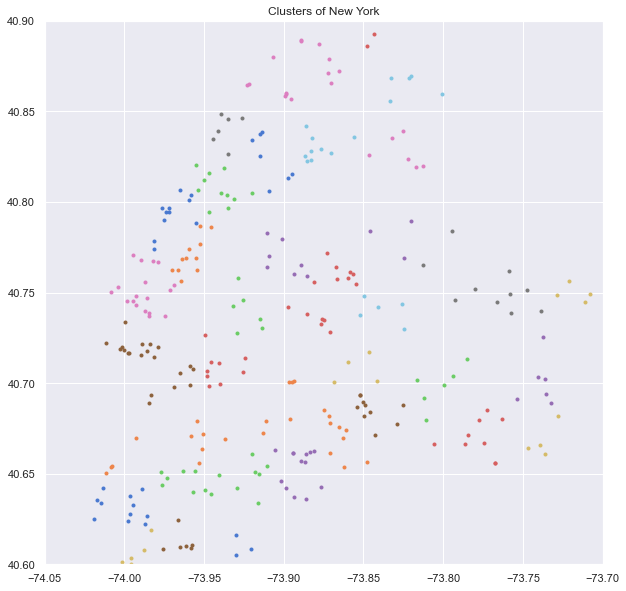

In [44]:

plt.figure(figsize = (10,10))
for label in df_fat.label.unique():
    plt.plot(df_fat.LONGITUDE[df_fat.label == label],df_fat.LATITUDE[df_fat.label == label],'.', alpha = 1)

plt.title('Clusters of New York')
plt.ylim(y_range)
plt.xlim(x_range)
plt.show()

In [45]:
df_fat.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,label
426,2018-09-10,2020-04-26 04:18:00,NaN,NaN,40.815525,-73.895030,POINT (-73.89503 40.815525),BRUCKNER EXPRESSWAY,NaN,NaN,...,NaN,NaN,NaN,4181883,NaN,NaN,NaN,NaN,NaN,8
597,2018-09-13,2020-04-26 09:43:00,NaN,NaN,40.769120,-73.955050,POINT (-73.95505 40.76912),EAST 74 STREET,NaN,NaN,...,NaN,NaN,NaN,3980123,CONCR,NaN,NaN,NaN,NaN,0
1019,2018-09-11,2020-04-26 21:42:00,NaN,NaN,40.633606,-73.916230,POINT (-73.91623 40.633606),FLATLANDS AVENUE,NaN,NaN,...,Unspecified,NaN,NaN,3980752,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,36
2268,2018-08-14,2020-04-26 16:52:00,BROOKLYN,11237,40.706367,-73.925354,POINT (-73.925354 40.706367),NaN,NaN,1177A FLUSHING AVENUE,...,NaN,NaN,NaN,3961152,Box Truck,NaN,NaN,NaN,NaN,6
2836,2018-08-15,2020-04-26 09:30:00,NaN,NaN,40.661488,-73.893890,POINT (-73.89389 40.661488),NEW LOTS AVENUE,NaN,NaN,...,Unspecified,NaN,NaN,3961655,Station Wagon/Sport Utility Vehicle,Sedan,Sedan,NaN,NaN,10


In [46]:
df.BOROUGH.isna().sum()

67361

In [47]:
df.shape

(294130, 29)

In [48]:
df_B = df.dropna(subset=['BOROUGH'])

In [49]:
# general imports
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import shapefile as shp
import json
import requests
import datetime
import warnings 
warnings.filterwarnings("ignore")
# itertools handles the cycling
import itertools 
from pprint import pprint

# bokeh imports
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.models import ColumnDataSource, FactorRange
from bokeh.models import Legend
from bokeh.core.properties import value
from bokeh.transform import factor_cmap
# select a palette
from bokeh.palettes import Spectral3
from bokeh.palettes import Category20b_13 as palette
from bokeh.palettes import Category20b_14 as palette2
from bokeh.transform import dodge

# sklearn imports
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, log_loss
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import log_loss
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn import datasets, metrics, model_selection, svm
from sklearn.metrics import classification_report


sns.set(style= 'whitegrid', palette='pastel', color_codes=True)
sns.mpl.rc('figure', figsize=(10,6))
# Set a plot style for nice plots.
plt.style.use('ggplot')

# Magic command useful jupyter notebook
%matplotlib inline

#Set plot size.
plt.rcParams['figure.figsize'] = [13,7]

#Set font size
plt.rcParams.update({'font.size':16})

In [51]:
df.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,2018-09-03,2020-04-26 21:39:00,NaN,NaN,40.749172,-73.967026,POINT (-73.967026 40.749172),FDR DRIVE,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3973213,Sedan,Sedan,Station Wagon/Sport Utility Vehicle,Sedan,Station Wagon/Sport Utility Vehicle
1,2018-09-07,2020-04-26 19:20:00,BROOKLYN,11223,40.600590,-73.961370,POINT (-73.96137 40.60059),CONEY ISLAND AVENUE,AVENUE T,NaN,...,Unspecified,NaN,NaN,NaN,3976336,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN
2,2018-09-06,2020-04-26 11:17:00,NaN,NaN,40.608757,-74.038086,POINT (-74.038086 40.608757),VERRAZANO BRIDGE LOWER,NaN,NaN,...,Unspecified,Unspecified,Unspecified,Unspecified,3975964,Sedan,Sedan,Sedan,Sedan,Sedan
3,2018-09-03,2020-04-26 21:50:00,QUEENS,11412,40.686450,-73.761185,POINT (-73.761185 40.68645),FARMERS BOULEVARD,120 AVENUE,NaN,...,Unspecified,NaN,NaN,NaN,3973840,Motorcycle,Sedan,NaN,NaN,NaN
4,2018-09-02,2020-04-26 14:28:00,QUEENS,11374,40.713165,-73.859620,POINT (-73.85962 40.713165),NaN,NaN,69-28 WOODHAVEN BOULEVARD,...,Unspecified,NaN,NaN,NaN,3972428,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN


In [91]:
df_B.shape

(226769, 30)

In [92]:
df_hour = df_B
df_hour['Time'] = df_hour['CRASH TIME'].dt.hour
df_hour = df_hour[['BOROUGH','Time','COLLISION_ID']]

In [93]:
borough = df_hour.BOROUGH.unique()
hours = [str(elem) for elem in df_hour['Time'].to_list()]

In [94]:
df_hour = pd.pivot_table(df_hour, values='COLLISION_ID', index=['Time'], columns=['BOROUGH'], aggfunc='count').fillna(0)

In [95]:
source = ColumnDataSource(df_hour)
colors = itertools.cycle(palette)

In [96]:
output_notebook()

Loading BokehJS ...

In [97]:
p = figure(width=900, height=400)
bar ={} # to store vbars
items = [] # to store the legend labels. 

# Create plots for each focuscrimes
for indx,i in enumerate(zip(borough,colors)):
    bar[i[0]] = p.vbar(x=dodge('Time',0.5), top=i[0],width = 0.9,source= source,muted_alpha = 0.1, muted = True,color=i[1]) 
    items.append((i[0], [bar[i[0]]]))
legend = Legend(items=items, location=(0,10),click_policy="mute")
p.add_layout(legend, 'right')

# Set axis properties and labels
p.title.text = "Accidents per hour"
p.grid.grid_line_alpha = 0.5
p.xaxis.axis_label = 'Hour of the day'
p.yaxis.axis_label = 'Relative Frequency'
p.ygrid.band_fill_color = "olive"
p.ygrid.band_fill_alpha = 0.1

In [98]:
show(p) #displays your plot

In [79]:
df_year = df_B
df_year['CRASH DATE'] = df_year['CRASH DATE'].dt.year
df_year = df_year[['BOROUGH','CRASH DATE','COLLISION_ID']]

In [82]:
df_year

,BOROUGH,CRASH DATE,COLLISION_ID
1,BROOKLYN,2018,3976336
3,QUEENS,2018,3973840
4,QUEENS,2018,3972428
5,QUEENS,2018,3986352
6,BROOKLYN,2018,3975052
...,...,...,...
334839,QUEENS,2012,203762
334840,BRONX,2012,72660
334841,MANHATTAN,2012,13925
334842,BROOKLYN,2012,135070


In [85]:
borough = df_year.BOROUGH.unique()
year = [str(elem) for elem in df_year['CRASH DATE'].to_list()]

df_year = pd.pivot_table(df_year, values='COLLISION_ID', index=['CRASH DATE'], columns=['BOROUGH'], aggfunc='count').fillna(0)



In [86]:
source = ColumnDataSource(df_year)
colors = itertools.cycle(palette)

output_notebook()

Loading BokehJS ...

In [89]:
q = figure(width=900, height=400)
bar ={} # to store vbars
items = [] # to store the legend labels. 

# Create plots for each focuscrimes
for indx,i in enumerate(zip(borough,colors)):
    bar[i[0]] = q.vbar(x=dodge('CRASH DATE',0.5), top=i[0],width = 0.9,source= source,muted_alpha = 0.1, muted = True,color=i[1]) 
    items.append((i[0], [bar[i[0]]]))
legend = Legend(items=items, location=(0,10),click_policy="mute")
q.add_layout(legend, 'right')

# Set axis properties and labels
q.title.text = "Accidents per year"
q.grid.grid_line_alpha = 0.5
q.xaxis.axis_label = 'Year'
q.yaxis.axis_label = 'Relative Frequency'
q.ygrid.band_fill_color = "olive"
q.ygrid.band_fill_alpha = 0.1
show(q)

In [101]:
from bokeh.layouts import row
from bokeh.layouts import gridplot

In [100]:
show(row(p,q))

In [103]:
grid = gridplot([[p,q]])

In [104]:
show(grid)

In [105]:
from bokeh.io import output_file, show
from bokeh.models import ColumnDataSource, FactorRange
from bokeh.plotting import figure

In [243]:
df_B

,CRASHDATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,Time
1,2018,2020-04-26 19:20:00,BROOKLYN,11223,40.600590,-73.961370,POINT (-73.96137 40.60059),CONEY ISLAND AVENUE,AVENUE T,NaN,...,NaN,NaN,NaN,3976336,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN,19
3,2018,2020-04-26 21:50:00,QUEENS,11412,40.686450,-73.761185,POINT (-73.761185 40.68645),FARMERS BOULEVARD,120 AVENUE,NaN,...,NaN,NaN,NaN,3973840,Motorcycle,Sedan,NaN,NaN,NaN,21
4,2018,2020-04-26 14:28:00,QUEENS,11374,40.713165,-73.859620,POINT (-73.85962 40.713165),NaN,NaN,69-28 WOODHAVEN BOULEVARD,...,NaN,NaN,NaN,3972428,Station Wagon/Sport Utility Vehicle,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,14
5,2018,2020-04-26 21:35:00,QUEENS,11101,40.753284,-73.920490,POINT (-73.92049 40.753284),NORTHERN BOULEVARD,42 PLACE,NaN,...,NaN,NaN,NaN,3986352,Sedan,NaN,NaN,NaN,NaN,21
6,2018,2020-04-26 08:30:00,BROOKLYN,11230,40.617382,-73.965744,POINT (-73.965744 40.617382),AVENUE M,EAST 9 STREET,NaN,...,NaN,NaN,NaN,3975052,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
334839,2012,2020-04-26 06:30:00,QUEENS,11419,40.691406,-73.812719,POINT (-73.8127193 40.6914065),LIBERTY AVENUE,134 STREET,NaN,...,NaN,NaN,NaN,203762,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,6
334840,2012,2020-04-26 17:30:00,BRONX,10454,40.806874,-73.919721,POINT (-73.9197215 40.8068735),BROOK AVENUE,EAST 137 STREET,NaN,...,NaN,NaN,NaN,72660,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,17
334841,2012,2020-04-26 14:45:00,MANHATTAN,10003,40.729186,-73.987249,POINT (-73.9872492 40.7291862),EAST 9 STREET,2 AVENUE,NaN,...,NaN,NaN,NaN,13925,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,14
334842,2012,2020-04-26 23:09:00,BROOKLYN,11203,40.653327,-73.938290,POINT (-73.9382899 40.6533268),LINDEN BOULEVARD,EAST 42 STREET,NaN,...,NaN,NaN,NaN,135070,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,23


In [232]:
df_bar = df_B

In [233]:
df_bar.rename(columns={'CRASH DATE':'CRASHDATE'},inplace=True)

In [234]:
df_bar['CRASHDATE'] = df_bar['CRASHDATE'].astype(str)

In [257]:
group_bar = df_bar.groupby(by=['CRASHDATE','BOROUGH'])

source = ColumnDataSource(group_bar)

In [263]:
index_cmap = factor_cmap('CRASHDATE_BOROUGH', palette=palette, factors=sorted(df_bar.CRASHDATE.unique()), end=1)

In [264]:
output_notebook()

Loading BokehJS ...

In [275]:
TOOLTIPS = tooltips=[('Inuries','@Time_count')]


p= figure(plot_width=800, plot_height=300, title="Injuries",
           x_range=group_bar,tooltips =TOOLTIPS)


In [276]:
p.vbar(x='CRASHDATE_BOROUGH',top='NUMBER OF PERSONS INJURED_count', width=1, source=source,
       line_color="white", fill_color=index_cmap, )

p.y_range.start = 0
p.x_range.range_padding = 0.05
p.xgrid.grid_line_color = None
p.xaxis.major_label_orientation = 1.2
p.outline_line_color = None

show(p)

In [322]:
df_bar.killed

1         0.0
3         0.0
4         0.0
5         0.0
6         0.0
         ... 
334839    0.0
334840    0.0
334841    0.0
334842    0.0
334843    0.0
Name: killed, Length: 226765, dtype: object

In [332]:
df_bar = df_B
df_bar.rename(columns={'NUMBER OF PERSONS KILLED':'killed'},inplace=True)
df_bar["killed"] = df_bar.killed.astype(float)
df_bar = df_bar.loc[df_bar.killed >0]

In [337]:
df_bar['CRASHDATE'] = df_bar['CRASHDATE'].astype(str)
df_bar['killed'] = df_bar['killed'].astype(str)

group_bar = df_bar.groupby(by=['BOROUGH','killed'])

In [338]:
TOOLTIPS = tooltips=[('Inuries','@Time_count')]


p= figure(plot_width=800, plot_height=300, title="Injuries",
           x_range=group_bar,tooltips =TOOLTIPS)


p.vbar(x='BOROUGH_killed',top='NUMBER OF PERSONS INJURED_count', width=1, source=source,
       line_color="white", fill_color=index_cmap, )

p.y_range.start = 0
p.x_range.range_padding = 0.05
p.xgrid.grid_line_color = None
p.xaxis.major_label_orientation = 1.2
p.outline_line_color = None

show(p)